In [1]:
import sys
sys.path.append('/home/elilouis/sublimationofsnow')
import sosutils
import pandas as pd
import datetime as dt
import xarray as xr

import altair as alt
import matplotlib.pyplot as plt

In [2]:
sos_download_dir='/data2/elilouis/sublimationofsnow/sosnoqc'
DATE_FORMAT_STR = '%Y%m%d'
start_date = "20221201"
end_date = "20230214"

In [3]:
datelist = pd.date_range(dt.datetime.strptime(start_date, DATE_FORMAT_STR),dt.datetime.strptime(end_date, DATE_FORMAT_STR),freq='d').strftime('%Y%m%d').tolist()

In [4]:
VARIABLE_NAMES = [  
    'spd_1m_ue',     'dir_1m_ue',     'u_1m_ue',   'v_1m_ue',   'w_1m_ue',   'u_w__1m_ue',    'v_w__1m_ue',  'u_tc__1m_ue',  'v_tc__1m_ue',   'u_h2o__1m_ue',  'v_h2o__1m_ue',   'w_tc__1m_ue',   'w_h2o__1m_ue',
    'spd_3m_ue',     'dir_3m_ue',     'u_3m_ue',   'v_3m_ue',   'w_3m_ue',   'u_w__3m_ue',    'v_w__3m_ue',  'u_tc__3m_ue',  'v_tc__3m_ue',   'u_h2o__3m_ue',  'v_h2o__3m_ue',   'w_tc__3m_ue',   'w_h2o__3m_ue',
    'spd_10m_ue',    'dir_10m_ue',    'u_10m_ue',  'v_10m_ue',  'w_10m_ue',  'u_w__10m_ue',   'v_w__10m_ue', 'u_tc__10m_ue', 'v_tc__10m_ue',  'u_h2o__10m_ue', 'v_h2o__10m_ue',  'w_tc__10m_ue',  'w_h2o__10m_ue',
    
    'tc_1m_ue', 'tc_3m_ue', 'tc_10m_ue',

    'P_10m_ue',

    'SF_avg_1m_ue', 'SF_avg_2m_ue',

    'T_1m_c', 'T_2m_c', 'T_3m_c', 'T_4m_c', 'T_5m_c', 'T_6m_c', 'T_7m_c', 'T_8m_c', 'T_9m_c', 'T_10m_c', 
    'T_11m_c', 'T_12m_c', 'T_13m_c', 'T_14m_c', 'T_15m_c','T_16m_c', 'T_17m_c', 'T_18m_c', 'T_19m_c', 'T_20m_c',

    'RH_1m_c', 'RH_2m_c', 'RH_3m_c', 'RH_4m_c', 'RH_5m_c', 'RH_6m_c', 'RH_7m_c', 'RH_8m_c', 'RH_9m_c', 'RH_10m_c', 
    'RH_11m_c','RH_12m_c','RH_13m_c','RH_14m_c','RH_15m_c','RH_16m_c','RH_17m_c','RH_18m_c','RH_19m_c', 'RH_20m_c',
]

In [5]:
datasets = [xr.open_dataset(sosutils.download_sos_data_day(date, sos_download_dir, cache=True))[VARIABLE_NAMES] for date in datelist]

Caching...skipping download for 20221201
Caching...skipping download for 20221202
Caching...skipping download for 20221203
Caching...skipping download for 20221204
Caching...skipping download for 20221205
Caching...skipping download for 20221206
Caching...skipping download for 20221207
Caching...skipping download for 20221208
Caching...skipping download for 20221209
Caching...skipping download for 20221210
Caching...skipping download for 20221211
Caching...skipping download for 20221212
Caching...skipping download for 20221213
Caching...skipping download for 20221214
Caching...skipping download for 20221215
Caching...skipping download for 20221216
Caching...skipping download for 20221217
Caching...skipping download for 20221218
Caching...skipping download for 20221219
Caching...skipping download for 20221220
Caching...skipping download for 20221221
Caching...skipping download for 20221222
Caching...skipping download for 20221223
Caching...skipping download for 20221224
Caching...skippi

In [6]:
sos_ds = sosutils.merge_datasets_with_different_variables(datasets, dim='time')

In [7]:
sos_ds_60min = sos_ds.resample(time='60Min').median() # NOTE: MEDIAN HERE
sos_tidy_df_60min = sosutils.get_tidy_dataset(sos_ds_60min, VARIABLE_NAMES)

In [8]:
sos_df = sos_ds.to_dataframe().reset_index()

Compare daily vertical moisture fluxes and blowing/saltating snow fluxes

In [9]:
src = sos_df[['time','w_h2o__1m_ue', 'SF_avg_1m_ue']]
src = src.assign(date = sos_df['time'].dt.date)
src = src.groupby('date').mean(numeric_only=True).reset_index()

In [11]:
src['daily_vertical_moisture_flux'] = src['w_h2o__1m_ue']*3600*24 # comes in g/m^2/s, covnvert to g/m^2/day
src['daily_snow_flux'] = src['SF_avg_1m_ue']*3600*24 # comes in g/m^2/s, covnvert to g/m^2/day

In [12]:
# src = src.query("daily_snow_flux > 0")

In [10]:
alt.Chart(src.drop(columns='date').query("daily_snow_flux < 10000")).mark_bar().encode(
    alt.X("daily_snow_flux:Q", bin=alt.Bin(maxbins=50), scale=alt.Scale(domain=[0,6000], clamp=True)),
    y='count()',
)

UndefinedVariableError: name 'daily_snow_flux' is not defined

In [14]:
alt.Chart(src.drop(columns='date')).mark_point().encode(
    alt.X('daily_snow_flux', scale=alt.Scale(domain=[0,6000], clamp=True), title='Daily Snow Flux (g/m^2/day)'),
    alt.Y('daily_vertical_moisture_flux', title='Daily Vertical Moisture Flux (g/m^2/day)')
)

/home/elilouis/mambaforge/envs/arm/lib/python3.11/site-packages/altair/utils/core.py:317: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for col_name, dtype in df.dtypes.iteritems():


alt.Chart(...)

remove outliers (10kg/m^2/day is the threshold) - we drop 3 days of data

In [15]:
len(src), len(src.query("daily_snow_flux < 10000"))

(76, 73)

In [16]:
src = src.query("daily_snow_flux < 10000")

In [17]:
len(src.query("daily_snow_flux < 10")), len(src.query("daily_snow_flux >= 10"))

(30, 43)

so far there have been 30 days with little to no saltating/blowing snow (threshold of 10g/m^2/day) and 43 days with saltating/blowing snow

In [18]:
src.query("daily_snow_flux < 10")['daily_vertical_moisture_flux'].sum(), src.query("daily_snow_flux >= 10")['daily_vertical_moisture_flux'].sum()

(6.2249365, 5377.4517)

we find a total of 6 g/m^2 vertical moisture flux over 30 non-blowing snow days

5377 g/m^2 vertical moisture flux over 43 blowing snow days

now converting to mm...

In [19]:
src.query("daily_snow_flux < 10")['daily_vertical_moisture_flux'].sum()/997, \
src.query("daily_snow_flux >= 10")['daily_vertical_moisture_flux'].sum()/997

(0.006243667487753788, 5.393632557829739)

we find a total of 0.0062 mm vertical moisture flux over 30 non-blowing snow days

5.4 mm vertical moisture flux over 43 blowing snow days

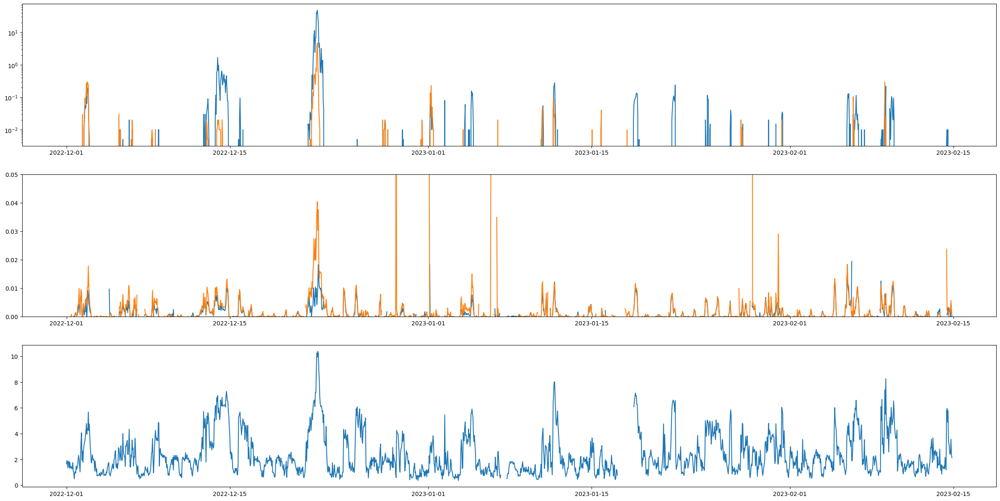

In [28]:
fig, axes = plt.subplots(3, 1, figsize=(30,15))

axes[0].plot(
    sos_tidy_df_60min.query("variable == 'SF_avg_1m_ue'")['time'],
    sos_tidy_df_60min.query("variable == 'SF_avg_1m_ue'")['value']
)
axes[0].plot(
    sos_tidy_df_60min.query("variable == 'SF_avg_2m_ue'")['time'],
    sos_tidy_df_60min.query("variable == 'SF_avg_2m_ue'")['value']
)
# axes[0].set_ylim(0,5)
axes[0].set_yscale('log')

axes[1].plot(
    sos_tidy_df_60min.query("variable == 'w_h2o__1m_ue'")['time'],
    sos_tidy_df_60min.query("variable == 'w_h2o__1m_ue'")['value'],
    label="w'q' at 1m"
)
axes[1].plot(
    sos_tidy_df_60min.query("variable == 'w_h2o__3m_ue'")['time'],
    sos_tidy_df_60min.query("variable == 'w_h2o__3m_ue'")['value'],
    label="w'q' at 3m"
)
axes[1].set_ylim(0,0.05)

axes[2].plot(
    sos_tidy_df_60min.query("variable == 'spd_1m_ue'")['time'],
    sos_tidy_df_60min.query("variable == 'spd_1m_ue'")['value'],
    label="w'q' at 3m"
)

In [30]:
alt.data_transformers.disable_max_rows()
alt.Chart(
    sos_tidy_df_60min
).transform_filter(
    alt.FieldOneOfPredicate('measurement', ['w_h2o_', 'snow flux'])
).mark_line().encode(
    alt.X("time:T"),
    alt.Y("value:Q"),
    alt.Color("height:N"),
    alt.Facet("measurement", columns=1)
).resolve_scale(y='independent').properties(width=1200, height=200)

alt.Chart(...)